## **Install required packages and import necessary libraries**

In [ ]:
!pip install geopandas
!pip install osmnx
!pip install folium
!pip uninstall numpy
!pip install numpy
!pip install -U numpy
import pandas as pd



In [ ]:
!pip install pysal esda libpysal
import osmnx as ox
import geopandas as gpd
from shapely import wkt
import folium
from tqdm import tqdm
import seaborn
import math
import json
import libpysal as lps
import esda
import matplotlib.pyplot as plt
from splot.esda import moran_scatterplot
from esda.moran import Moran
from libpysal.weights import Queen
from esda.moran import Moran

## **Download the OpenStreetMap data for the area and extract water bodies**

In [ ]:
# Define the name of the area for which you want to download data
place_name = "Pakistan"

# Download the OpenStreetMap data for the area
tags = {'water': True, 'natural': 'water', 'landuse': 'reservoir'}
gdf = ox.geometries_from_place(place_name, tags)

In [ ]:
gdf.shape

(7448, 133)

In [ ]:
# Filter the data to include only water bodies
wbd = gdf[gdf['geometry'].geom_type == 'Polygon']

In [ ]:
wbd = wbd[['geometry', 'water', 'name']] 

In [ ]:
wbd.dropna(inplace=True)

In [ ]:
wbd = wbd[wbd["water"]=="river"]

In [ ]:
wbd.to_file("wbd.gpkg", crs="EPSG:4326", driver="GPKG")

In [ ]:
wbd = gpd.read_file("/content/wbd.gpkg")

In [ ]:
wbd.head()

,element_type,osmid,water,name,geometry
0,relation,416398,river,دریائے سندھ,"POLYGON ((68.00317 24.74555, 68.00389 24.74650..."
1,way,27806364,river,دریائے سندھ,"POLYGON ((68.02282 24.82143, 68.02296 24.82183..."
2,way,850270793,river,Nai Baran River,"POLYGON ((67.94292 25.40883, 67.94316 25.40955..."
3,relation,38223,river,دریائے سندھ,"POLYGON ((67.93868 26.26488, 67.94029 26.26577..."
4,relation,38224,river,دریائے سندھ,"POLYGON ((67.91847 26.56260, 67.91972 26.56197..."


In [ ]:
wbd.shape

(387, 4)

## **Plot the Water Bodies**


<Axes: >

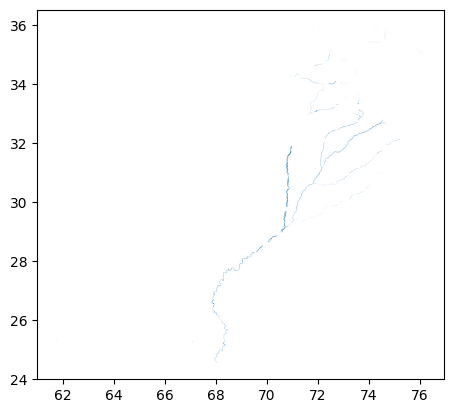

In [ ]:
wbd.plot()

## **Calculating centroids and ploting circular markers for the water bodies**

In [ ]:
wbd['centroid'] = wbd['geometry'].centroid

In [ ]:
wbd['latitude'] = wbd['centroid'].y
wbd['longitude'] = wbd['centroid'].x

In [ ]:
m = folium.Map(location=[30.85, 72.31667], zoom_start=6)

In [ ]:
for idx, row in wbd.iterrows():
    folium.CircleMarker([row['latitude'], row['longitude']], radius=2).add_to(m)

In [ ]:
m

In [ ]:
wbd.head()

,element_type,osmid,water,name,geometry,centroid,latitude,longitude
0,relation,416398,river,دریائے سندھ,"POLYGON ((68.00317 24.74555, 68.00389 24.74650...",POINT (67.99657 24.65934),24.659337,67.996567
1,way,27806364,river,دریائے سندھ,"POLYGON ((68.02282 24.82143, 68.02296 24.82183...",POINT (68.04311 24.81660),24.816599,68.043107
2,way,850270793,river,Nai Baran River,"POLYGON ((67.94292 25.40883, 67.94316 25.40955...",POINT (67.94593 25.40832),25.408319,67.945928
3,relation,38223,river,دریائے سندھ,"POLYGON ((67.93868 26.26488, 67.94029 26.26577...",POINT (67.91474 26.31704),26.317042,67.914737
4,relation,38224,river,دریائے سندھ,"POLYGON ((67.91847 26.56260, 67.91972 26.56197...",POINT (67.91383 26.51057),26.510570,67.913832


In [ ]:

# Save the map as an HTML file
m.save("map.html")

# Alternatively, save the map as a PNG image
m.save("map.png")

## **Extract building data using OSMnx, filter based on water bodies buffer radius and plot**

In [ ]:
idx = 100
cp = wbd.iloc[idx]["latitude"], wbd.iloc[idx]["longitude"]
cp

(30.352015670870397, 71.40605820238632)

In [ ]:
radius = 25000

In [ ]:
import math

radius = 25000
buildings = gpd.GeoDataFrame()
buildings_counts = []

# Calculating the number of rows in the DataFrame
num_rows = len(wbd)

# Calculating the index to split the DataFrame
split_index = math.ceil(num_rows / 2)

# First half of the loop
for idx, row in tqdm(wbd.iloc[:split_index].iterrows()):
    cp = row['latitude'], row['longitude']
    buildings_within_radius = ox.geometries_from_point(cp, tags={'building': True}, dist=radius)
    buildings = buildings.append(buildings_within_radius, ignore_index=True)
    buildings_counts.append(len(buildings_within_radius))



In [ ]:
bd = buildings[buildings['geometry'].geom_type == 'Polygon']
bd = bd[['geometry', 'building']] 
bd.dropna(inplace=True)
bd = gpd.GeoDataFrame(bd, geometry='geometry')
bd.to_file("bd.gpkg", crs="EPSG:4326", driver="GPKG")

In [ ]:
buildings = gpd.GeoDataFrame()
buildings_counts = []
# Second half of the loop
for idx, row in tqdm(wbd.iloc[split_index:].iterrows()):
    cp = row['latitude'], row['longitude']
    buildings_within_radius = ox.geometries_from_point(cp, tags={'building': True}, dist=radius)
    buildings = buildings.append(buildings_within_radius, ignore_index=True)
    buildings_counts.append(len(buildings_within_radius))


In [ ]:
bd1 = buildings[buildings['geometry'].geom_type == 'Polygon']
bd1 = bd1[['geometry', 'building']] 
bd1.dropna(inplace=True)
bd1 = gpd.GeoDataFrame(bd1, geometry='geometry')
bd1.to_file("bd1.gpkg", crs="EPSG:4326", driver="GPKG")

In [ ]:
gpkg_file1 = '/content/bd.gpkg'
gpkg_file2 = '/content/bd1.gpkg'

In [ ]:
# Read the data from the GPKG files
data1 = gpd.read_file(gpkg_file1)
data2 = gpd.read_file(gpkg_file2)


In [ ]:
# Merge the data
buildings_data = data1.append(data2, ignore_index=True)

# Write the merged data to a new GPKG file
buildings_data.to_file("bd.gpkg", crs="EPSG:4326", driver="GPKG")

In [ ]:
bd['centroid'] = bd['geometry'].centroid
bd['latitude'] = bd['centroid'].y
bd['longitude'] = bd['centroid'].x

In [ ]:
m = folium.Map(location=[30.85, 72.31667], zoom_start=6)

l = len(bd) // 30000
i = 0
for idx, row in bd.iterrows():
    if i % l == 0:
      folium.CircleMarker([row['latitude'], row['longitude']], radius=1, color='brown').add_to(m)
    i += 1

In [ ]:
m

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<Axes: >

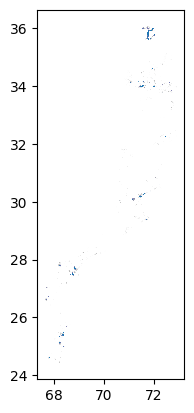

In [ ]:
bd.plot()

# **Obtaining building count in the specified radius**



In [ ]:
radius = 25000
buildings_counts = []
for idx, row in tqdm(wbd.iterrows()):
    # folium.CircleMarker([row['latitude'], row['longitude']], radius=2).add_to(m)
    cp = row['latitude'],row['longitude']
    buildings = ox.geometries_from_point(cp, tags={'building': True}, dist=radius)
    buildings_counts.append(len(buildings))

51it [01:27,  1.36s/it]/usr/local/lib/python3.10/dist-packages/osmnx/geometries.py:359: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the active geometry column.
  gdf["geometry"] = np.nan
52it [01:28,  1.19s/it]/usr/local/lib/python3.10/dist-packages/osmnx/geometries.py:359: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry(

In [ ]:
wbd["buildings counts"] = buildings_counts

In [ ]:
wbd.head()

In [ ]:
wbd.dtypes

In [ ]:
wbd[['name', 'water', 'geometry', 'buildings counts']].to_file("wbd_25000.gpkg", crs="EPSG:4326", driver="GPKG")

## **Evaluating the maximum buildings using seaborn**

<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()


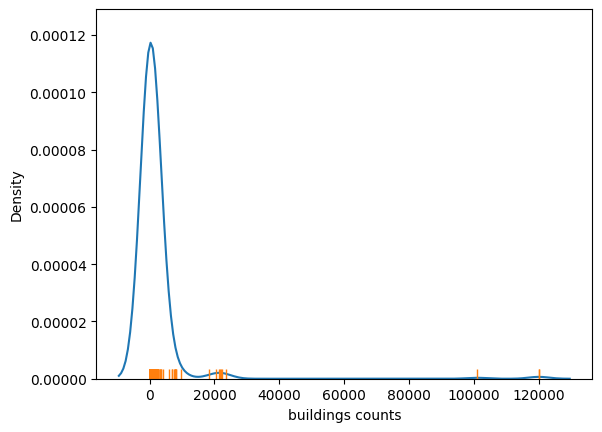

In [ ]:
# Draw KDE line
ax = seaborn.kdeplot(wbd["buildings counts"])
# Add one small bar (rug) for each observation
# along horizontal axis
seaborn.rugplot(wbd["buildings counts"], ax=ax);

In [ ]:
m = folium.Map(location=[30.85, 72.31667], zoom_start=6)

In [ ]:
# Set the desired radius in meters
desired_radius_meters = radius

# Calculate the radius in pixels based on the zoom level of the map
zoom_start = m.options['zoom']
map = {}

## **Circular markers with respect to number of buildings**

In [ ]:
for idx, row in wbd.iterrows():
  if row["buildings counts"]:
    if row["buildings counts"]>20000:
      c = "red"
      p = True
    elif row["buildings counts"]>5000:
      c = "orange"
      p = True
    elif row["buildings counts"] > 500:
      c = "yellow"
      p = True
    elif row["buildings counts"] > 100:
      c = "#FFCC99"
      p = True
    if p:
      meters_per_pixel = (156543.03392 * math.cos(math.radians(row['latitude']))) / (2 ** zoom_start)
      radius_pixels = desired_radius_meters / meters_per_pixel
      folium.CircleMarker([row['latitude'], 
                          row['longitude']], 
                          radius=radius_pixels, 
                          color=c, 
                          fill_color=c, 
                        fill_opacity=0.5).add_to(m)
      p=False

In [ ]:
m

In this plot, the color codes are according to number of buildings in the **25KM** radius region.


1. red > 10000 buildings
2. orange > 5000 buildings
3. yellow > 500 buildings
4. skin > 100 buildings



## **Loading District Data and joining with the Water Bodies Data**

In [ ]:
# Load the district shapefile
districts = gpd.read_file('/content/Pak_District_Boundary.shp')
print(districts)
# Check the CRS for districts
print("Initial Districts CRS:", districts.crs)

# Set the initial CRS if it's not set (replace 'initial_crs' with the correct CRS)
if districts.crs is None:
    districts = districts.set_crs(epsg=4326)
districts = districts.to_crs(epsg=4326)

# Check the CRS for districts
print("Transformed Districts CRS:", districts.crs)

# Check the CRS for districts
print("Districts CRS:", districts.crs)

# Load the water bodies GeoDataFrame (wbd)
wbd = gpd.read_file('/content/wbd_25000.gpkg')

# Set the CRS for the wbd GeoDataFrame
wbd = wbd.set_crs(epsg=4326)

# Check the CRS for wbd
print("WBD CRS:", wbd.crs)

# Perform a spatial join between the districts and water bodies
joined = gpd.sjoin(districts, wbd, how='inner', op='intersects')

print(districts)




In [ ]:
wbd.head()

,name,water,buildings counts,geometry,centroid,latitude,longitude
0,دریائے سندھ,river,1621,"POLYGON ((68.00317 24.74555, 68.00389 24.74650...",POINT (67.99657 24.65934),24.659337,67.996567
1,دریائے سندھ,river,970,"POLYGON ((68.02282 24.82143, 68.02296 24.82183...",POINT (68.04311 24.81660),24.816599,68.043107
2,Nai Baran River,river,34,"POLYGON ((67.94292 25.40883, 67.94316 25.40955...",POINT (67.94593 25.40832),25.408319,67.945928
3,دریائے سندھ,river,16,"POLYGON ((67.93868 26.26488, 67.94029 26.26577...",POINT (67.91474 26.31704),26.317042,67.914737
4,دریائے سندھ,river,706,"POLYGON ((67.91847 26.56260, 67.91972 26.56197...",POINT (67.91383 26.51057),26.510570,67.913832


In [ ]:
districts.head()

,DISTRICT,Division,Province,Country,geometry
0,Awaran,Kalat,Balochistan,Pakistan,"POLYGON ((65.90683 27.14291, 65.91685 27.13392..."
1,Barkhan,Zhob,Balochistan,Pakistan,"POLYGON ((69.98192 30.29809, 69.98682 30.29258..."
2,Chagai (At Dalbandin)\r\n,Quetta,Balochistan,Pakistan,"POLYGON ((62.43847 29.39412, 62.45577 29.38897..."
3,Dera Bugti,Sibi,Balochistan,Pakistan,"POLYGON ((69.60072 29.52588, 69.59336 29.49585..."
4,Gwadar,Mekran,Balochistan,Pakistan,"POLYGON ((62.07833 25.67401, 62.07422 25.65549..."


##**Using aggregated data to plot choropleth map**




In [ ]:
# Aggregate the building counts by district
agg_data = joined.groupby('DISTRICT')['buildings counts'].sum().reset_index()

# Merge the aggregated data back into the districts GeoDataFrame
districts_agg = districts.merge(agg_data, on='DISTRICT')

# Create the choropleth map
m = folium.Map(location=[30.85, 72.31667], zoom_start=6)

choropleth = folium.Choropleth(
    geo_data=districts_agg,
    data=districts_agg,
    columns=['DISTRICT', 'buildings counts'],
    key_on='feature.properties.DISTRICT',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Potential Infrastructural Damage'
).add_to(m)

folium.LayerControl().add_to(m)

m.save('choropleth_map.html')

In [ ]:
m

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()


## **Spatial Auto Correlation using Moran's Index**




In [ ]:
# Load the districts GeoDataFrame (districts_agg)
# Make sure it contains the aggregated building counts data

# Calculate the spatial weights matrix
# Use Queen contiguity weights as an example (you can also use other types of weights)
w = Queen.from_dataframe(districts_agg)

# Row standardize the spatial weights matrix
w.transform = 'R'

# Calculate Moran's I
moran = Moran(districts_agg['buildings counts'], w)

# Print the Moran's I statistic and the p-value
print(f"Moran's I: {moran.I}")
print(f"p-value: {moran.p_sim}")



('WARNING: ', 2, ' is an island (no neighbors)')
Moran's I: 0.41016737042750134
p-value: 0.002


/usr/local/lib/python3.10/dist-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
 There is 1 island with id: 2.
  warnings.warn(message)


**Areas which will suffer similar infrastructural damage are clustered together according to the indicative by the positive**

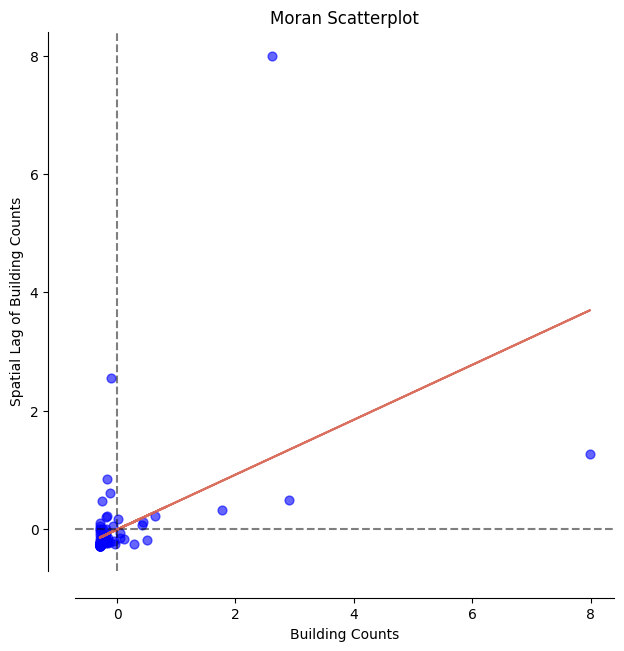

Moran scatterplot saved at: moran_scatterplot.png


In [ ]:
moran = Moran(districts_agg['buildings counts'], w)

# Create a Moran scatterplot
fig, ax = moran_scatterplot(moran,aspect_equal=True, scatter_kwds={'color': 'blue'})

# Set the plot title and labels
ax.set_title("Moran Scatterplot")
ax.set_xlabel("Building Counts")
ax.set_ylabel("Spatial Lag of Building Counts")

# Save the plot to a file
plot_path = 'moran_scatterplot.png'
plt.savefig(plot_path)
plt.show()
# Close the plot to release resources
plt.close(fig)

# Print the path to the saved plot
print(f"Moran scatterplot saved at: {plot_path}")










##**Conclusion**
The project aims to highlight infrastructural damage that might occur due to over flowing or flooding water bodies with not only respect to the water bodies themselves in a radius of 25 km but also district wise in order to take necessary measures in unforseen situations. The plots highlight the relation between areas close together. This not only can help in a disasterous situation but also provide a helping hand in preventive measures.